### Conceptualizing model runs on annual timestep

- Transitioning from monthly to annual - what would this imply if we treat alpha as a scaling parameter?

### Impact of host statistics on establishment probability

- Exploring range of host/sigma_h values and their impact on probability of introduction at different alpha values (monthly)
- If alpha parameter were used for temporal scaling, how would that impact probability of introduction at an annual timestep?

### Suggested conclusions:

- Instead of using the alpha parameter for scaling, suggest constraining alpha to 0 - 1 as the monthly baseline probability
- Calculate annual p_intro as the "at least one" probability over 12 events, ie. 1 - (1 - p_est) ** 12 or run binomial(12, p) to get annual outcomes over the monthly probabilities


In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import itertools
import math

<img src='../imgs/model_eqns.png' width=60%>

In [2]:
# Simulating monthly values of entry and establishment probability
# for a single country pair over 1 year

# Probabilities modeled as Gaussian...?

p_ent = np.random.normal(0.1, 0.05, 12)
p_est = np.random.normal(0.1, 0.05, 12)

print(f"Monthly probability of... \n\n Entry: {p_ent}\n\nEstablishment: {p_est}")

Monthly probability of... 

 Entry: [0.1095946  0.02522812 0.20177638 0.09352003 0.07453251 0.10437599
 0.17251076 0.18620752 0.07706052 0.03674546 0.1004148  0.1627654 ]

Establishment: [0.21849296 0.03422183 0.1093759  0.15071515 0.14772381 0.06812134
 0.08050717 0.094018   0.06273936 0.15541065 0.11888995 0.07391897]


In [3]:
# What the probability of introduction would look like for that country pair, on a single time step

mean_int = np.mean(p_est * p_ent)

print(f"Average monthly introduction probability: {mean_int}")

Average monthly introduction probability: 0.01208367933577327


In [4]:
# The overall probability of introduction over the course of the year, using monthly timesteps

p_int = 1 - np.prod(1 - p_ent * p_est)

print(f"Probability of introduction in 1-yr period: {p_int}")

Probability of introduction in 1-yr period: 0.1359763052794709


In [5]:
# Using alpha as the temporal scaling parameter
# Since alpha contributes multiplicatively to p entry (which is multiplied to get p intro)

# Annual probability/monthly probability ~ Annual alpha/monthly alpha

alpha_converter = p_int / mean_int

print(f"Example converter value:{alpha_converter}")

Example converter value:11.25288924846907


In [6]:
# Conducting multiple runs
alpha_converters = []

for i in range(0, 1000):
    p_ent = np.random.normal(0.1, 0.05, 12)
    p_est = np.random.normal(0.1, 0.05, 12)

    mean_int = np.mean(p_est * p_ent)
    p_int = 1 - np.prod(1 - p_ent * p_est)

    alpha_converter = p_int / mean_int
    alpha_converters.append(alpha_converter)
alpha_converters = np.array(alpha_converters)

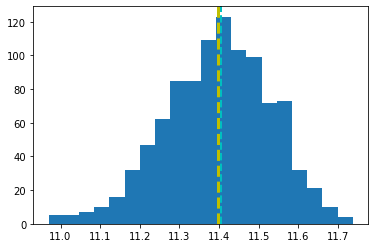

In [7]:
plt.hist(alpha_converters, bins=20)
plt.axvline(np.mean(alpha_converters), color="y", linestyle="dashed", linewidth=3)
plt.axvline(np.median(alpha_converters), color="c", linestyle="dashed", linewidth=2)
plt.show()

# Mean and median result similarly (entry/establishment probabilities with a normal distribution)

In [8]:
mean_alpha_converter = np.mean(alpha_converter)

print(
    f"Monthly alpha value should be multiplied by ~{round(mean_alpha_converter,2)} to get the equivalent annual value."
)

# But, this could potentially lead to p_est values greater than 1 - see below for thoughts on how to implement this.

Monthly alpha value should be multiplied by ~11.1 to get the equivalent annual value.


## How are host values impacting establishment probability?

In [9]:
# Static data values from SLF/MLN parameterization

beta = 0.5
delta_kappa_ijt = 0.5
sigma_kappa = 0.3638909849679002
phi = 1
w_phi = 1

# Modified establishment function from model_equations.py
# As a function of host area (vs. host-free area)


def probability_of_establishment(
    alpha,
    host_area,
    sigma_h,
    beta=beta,
    delta_kappa_ijt=delta_kappa_ijt,
    sigma_kappa=sigma_kappa,
    phi=phi,
    w_phi=w_phi,
):

    return (
        phi
        * w_phi
        * alpha
        * math.exp(
            (-1)
            * beta
            * (
                ((delta_kappa_ijt / sigma_kappa) ** 2)
                + (((1 - host_area) / sigma_h) ** 2)
            )
        )
    )

In [10]:
# Setting range of parameters

alpha = [round(a, 2) for a in list(np.arange(0.01, 1, 0.05))]
h_jt = [round(a, 2) for a in list(np.arange(0.0, 1, 0.05))]
sigma_h = [round(a, 2) for a in list(np.arange(0.0, 0.5, 0.025))]

param_list = [alpha, h_jt, sigma_h]
param_sets = list(itertools.product(*param_list))

In [11]:
parameters = pd.DataFrame(param_sets).rename(
    columns={0: "alpha", 1: "Host Area (1 - h_jt)", 2: "sigma_h"}
)
parameters["p_est"] = parameters.apply(
    lambda x: probability_of_establishment(
        x.alpha, x["Host Area (1 - h_jt)"], x.sigma_h
    ),
    axis=1,
)

C:\Users\ariel\Anaconda3\envs\Pandemic\lib\site-packages\ipykernel_launcher.py:30: RuntimeWarning: divide by zero encountered in double_scalars


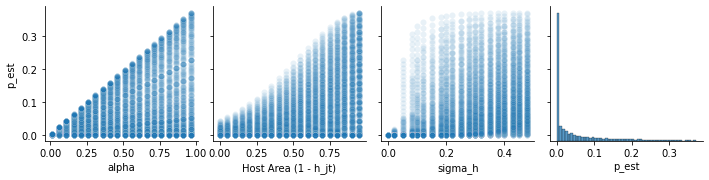

In [18]:
sns.pairplot(
    parameters,
    y_vars=["p_est"],
    x_vars=["alpha", "Host Area (1 - h_jt)", "sigma_h", "p_est"],
    plot_kws={"alpha": 0.1},
)
plt.show()

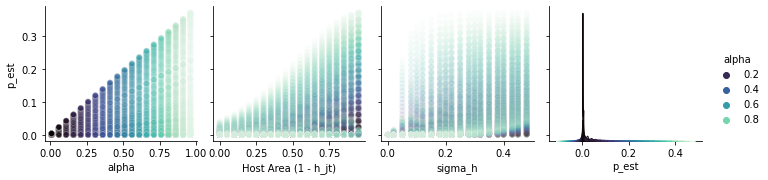

In [16]:
sns.pairplot(
    parameters,
    y_vars=["p_est"],
    x_vars=["alpha", "Host Area (1 - h_jt)", "sigma_h", "p_est"],
    hue="alpha",
    palette="mako",
    plot_kws={"alpha": 0.1},
)
plt.show()

### What would this imply with annual values for establishment?

In [14]:
parameters["p_est_yr_alpha"] = (
    parameters["p_est"] * mean_alpha_converter
)  # if treating alpha as a temporal scaling coefficient

parameters["p_est_yr_self"] = (
    1 - (1 - parameters["p_est"]) ** 12
)  # if calculating with at-least-one probability over 12 events

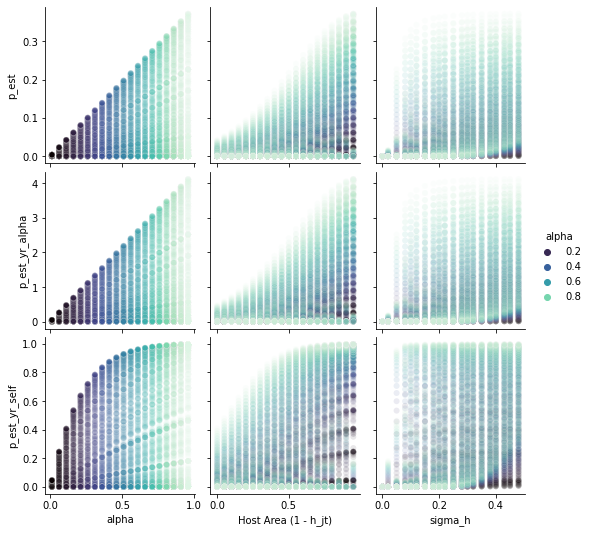

In [19]:
sns.pairplot(
    parameters,
    y_vars=["p_est", "p_est_yr_alpha", "p_est_yr_self"],
    x_vars=["alpha", "Host Area (1 - h_jt)", "sigma_h"],
    plot_kws={"alpha": 0.1},
    hue="alpha",
    palette="mako",
)
plt.show()

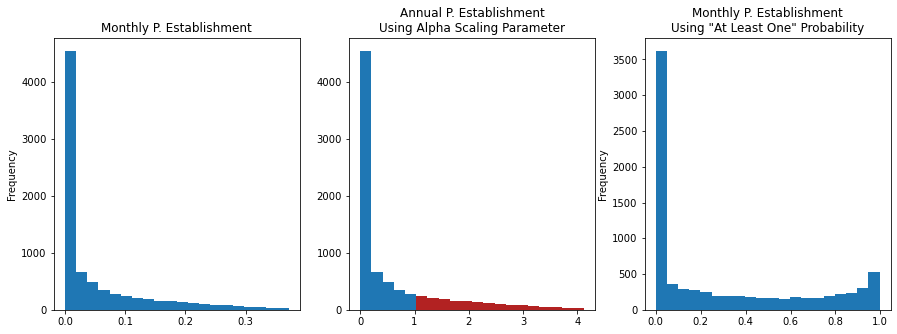

In [37]:
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 5))

n_bins = 20

parameters["p_est"].plot.hist(ax=ax1, bins=n_bins)
N, bins, patches = ax2.hist(parameters["p_est_yr_alpha"], bins=n_bins)
parameters["p_est_yr_self"].plot.hist(ax=ax3, bins=n_bins)

ax1.set_title("Monthly P. Establishment")
ax2.set_title("Annual P. Establishment\nUsing Alpha Scaling Parameter")

for bin, patch in zip(bins, patches):
    if bin >= 1:
        patch.set_facecolor("firebrick")
ax3.set_title('Monthly P. Establishment\nUsing "At Least One" Probability')

plt.show()